<a href="https://colab.research.google.com/github/rathi710/pothole_detection_using_custom_dataset_yolo-v8/blob/main/pothole_detection_on_custom_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Mon May 27 11:27:57 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   64C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [3]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.9/78.2 GB disk)


In [4]:
# Git clone method (for development)

# %cd {HOME}
# !git clone github.com/ultralytics/ultralytics
# %cd {HOME}/ultralytics
# !pip install -e .

# from IPython import display
# display.clear_output()

# import ultralytics
# ultralytics.checks()

In [5]:
from ultralytics import YOLO

from IPython.display import display, Image

## CLI Basics

If you want to train, validate or run inference on models and don't need to make any modifications to the code, using YOLO command line interface is the easiest way to get started. Read more about CLI in [Ultralytics YOLO Docs](https://docs.ultralytics.com/usage/cli/).

```
yolo task=detect    mode=train    model=yolov8n.yaml      args...
          classify       predict        yolov8n-cls.yaml  args...
          segment        val            yolov8n-seg.yaml  args...
                         export         yolov8n.pt        format=onnx  args...
```

## Inference with Pre-trained COCO Model

### 💻 CLI

`yolo mode=predict` runs YOLOv8 inference on a variety of sources, downloading models automatically from the latest YOLOv8 release, and saving results to `runs/predict`.

In [6]:
%cd {HOME}
!yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='https://media.roboflow.com/notebooks/examples/dog.jpeg' save=True

/content
100% 6.23M/6.23M [00:00<00:00, 88.6MB/s]
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

100% 104k/104k [00:00<00:00, 142MB/s]
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1 /content/dog.jpeg: 640x384 1 person, 1 car, 1 dog, 102.3ms
Speed: 14.2ms preprocess, 102.3ms inference, 761.0ms postprocess per image at shape (1, 3, 640, 384)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


/content


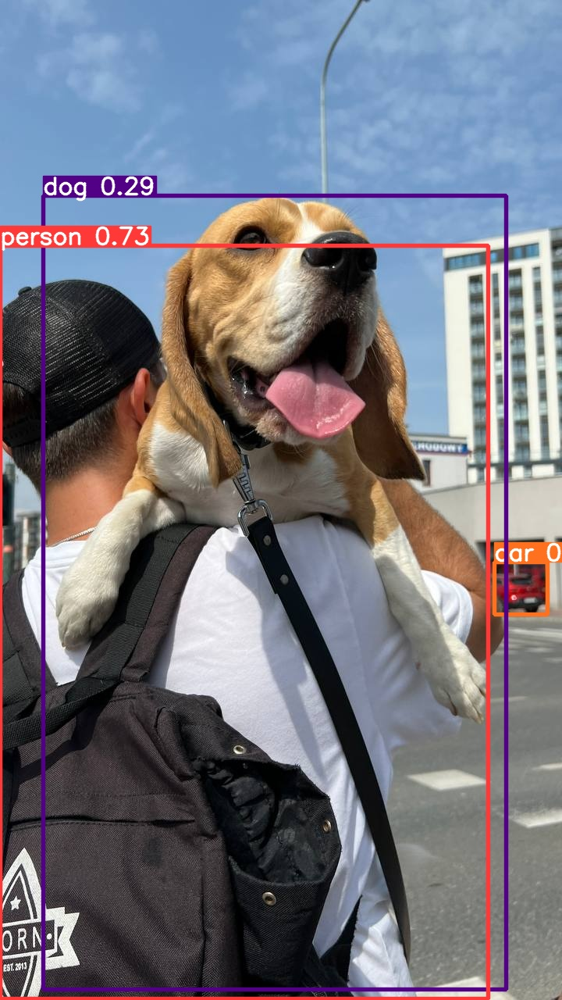

In [7]:
%cd {HOME}
Image(filename='runs/detect/predict/dog.jpeg', height=600)

### 🐍 Python SDK

The simplest way of simply using YOLOv8 directly in a Python environment.

In [8]:
model = YOLO(f'{HOME}/yolov8n.pt')
results = model.predict(source='https://media.roboflow.com/notebooks/examples/dog.jpeg', conf=0.25)


Found https://media.roboflow.com/notebooks/examples/dog.jpeg locally at dog.jpeg
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/1 /content/dog.jpeg: 640x384 1 person, 1 car, 1 dog, 231.5ms
Speed: 5.6ms preprocess, 231.5ms inference, 1083.5ms postprocess per image at shape (1, 3, 640, 384)


In [9]:
results[0].boxes.xyxy

tensor([[   0.0000,  314.4717,  625.0754, 1278.1946],
        [  55.1731,  250.0220,  648.1080, 1266.2720],
        [ 633.2291,  719.5391,  701.0538,  786.0336]], device='cuda:0')

In [10]:
results[0].boxes.conf

tensor([0.7271, 0.2907, 0.2846], device='cuda:0')

In [11]:
results[0].boxes.cls

tensor([ 0., 16.,  2.], device='cuda:0')

In [12]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow
from roboflow import Roboflow
rf = Roboflow(api_key="wDaFT1orOrdOXwBVTWN7")
project = rf.workspace("hi-wxm96").project("p-a4mbm")
dataset = project.version(1).download("yolov8-obb")


/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.5/75.5 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 14.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.8 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.7
    Uninstalling idna-3.7:
      Successfully uninstalled idna-3.7
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully unins

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to p-1 in yolov8-obb:: 100%|██████████| 412/412 [00:00<00:00, 5510.22it/s]


In [13]:
import os

def list_files_and_directories(directory_path):
    for root, dirs, files in os.walk(directory_path):
        print(f"Current directory: {root}")

        # List directories
        print("Directories:")
        for directory in dirs:
            print(os.path.join(root, directory))

        # List files
        print("Files:")
        for file in files:
            print(os.path.join(root, file))

# Replace 'your_directory_path' with the actual path you want to check
directory_path = '../datasets/roboflow'
list_files_and_directories(directory_path)

#file_path = {dataset.location} / 'data.yaml'

def show_file_content(file_path):
    try:
        with open(file_path, 'r') as file:
            content = file.read()
            print(content)
    except FileNotFoundError:
        print(f"Error: File not found - {file_path}")
    except Exception as e:
        print(f"Error: {e}")

# Replace 'your_file_path' with the actual path to the file you want to read
file_path = '../datasets/roboflow'
#show_file_content(file_path)

In [14]:
source = dataset.location


destination = '/content/datasets/roboflow'

import os


# Create the destination directory if it doesn't exist
os.makedirs(destination, exist_ok=True)

# Copy files from source to destination
!cp -r $source/* $destination



# Specify the current file name and the new file name
current_filename = 'old_file.txt'  # replace with the actual current file name
new_filename = 'new_file.txt'      # replace with the desired new file name

# Rename the file
#os.rename(current_filename, new_filename)


## Custom Training

In [15]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8s.pt data={dataset.location}/data.yaml epochs=10 imgsz=800 plots=True

/content
100% 21.5M/21.5M [00:00<00:00, 224MB/s]
New https://pypi.org/project/ultralytics/8.2.22 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/p-1/data.yaml, epochs=10, patience=50, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False

In [16]:
!ls {HOME}/runs/detect/train/

args.yaml					   labels.jpg	 train_batch0.jpg
confusion_matrix_normalized.png			   P_curve.png	 train_batch1.jpg
confusion_matrix.png				   PR_curve.png  train_batch2.jpg
events.out.tfevents.1716809402.2e218cd50427.779.0  R_curve.png	 val_batch0_labels.jpg
F1_curve.png					   results.csv	 val_batch0_pred.jpg
labels_correlogram.jpg				   results.png	 weights


/content


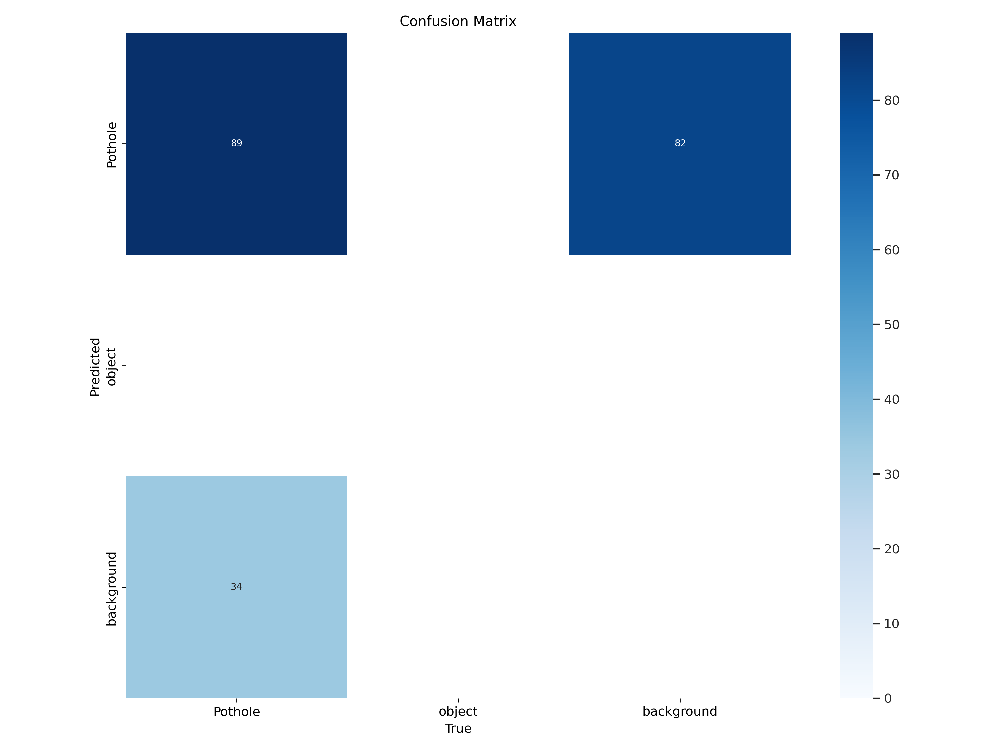

In [17]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

/content


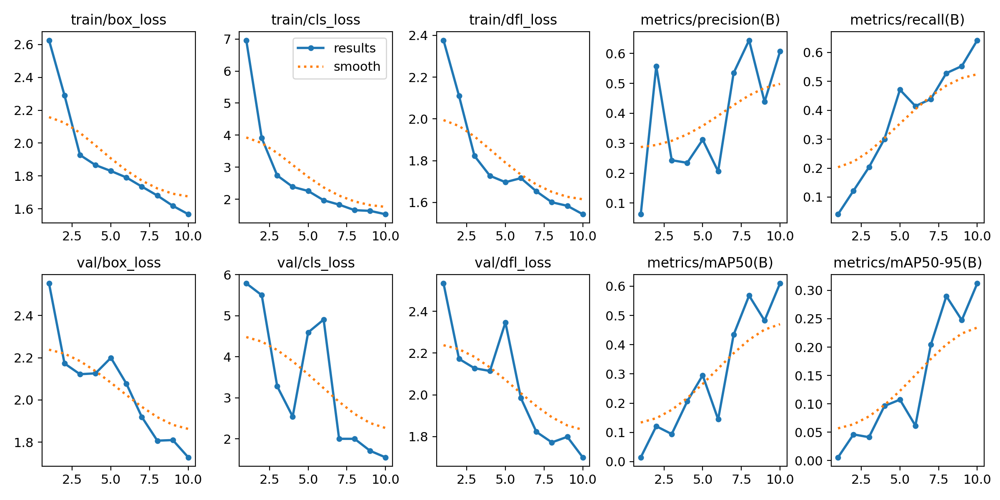

In [18]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

/content


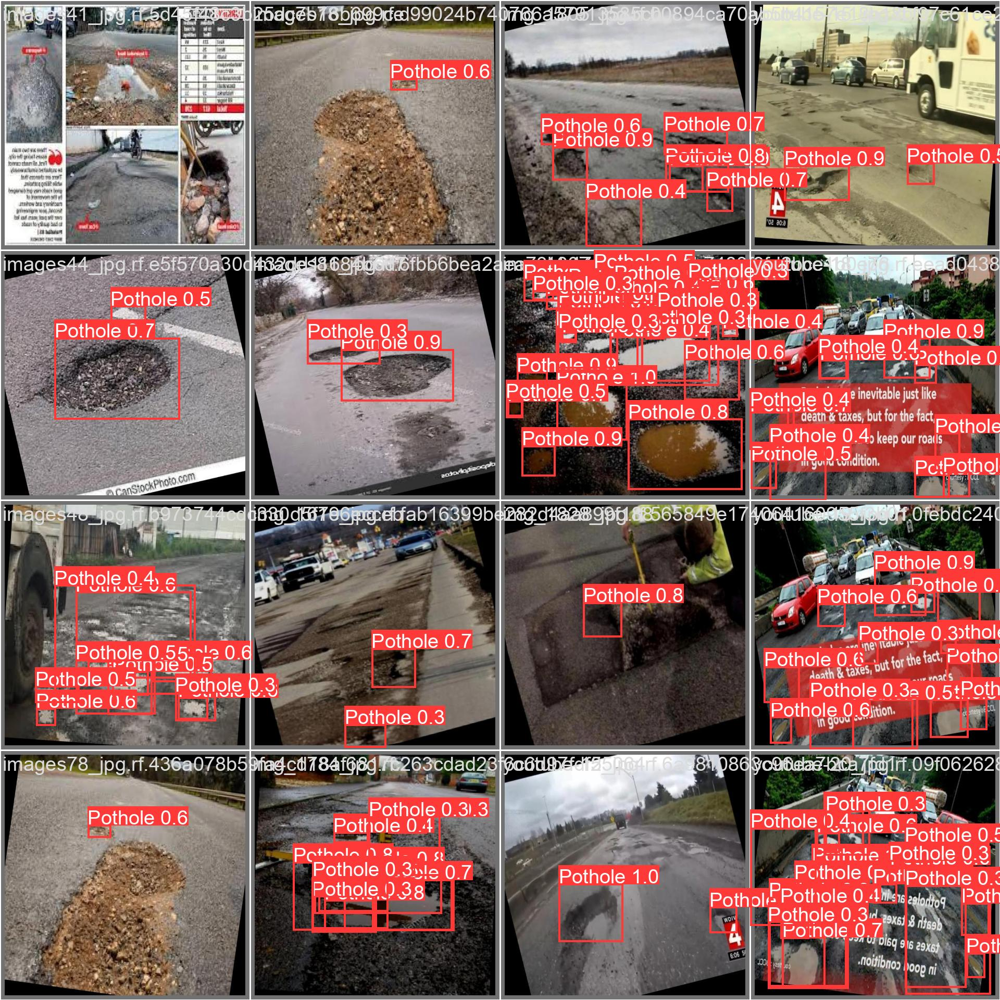

In [19]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

## Validate Custom Model

In [20]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/datasets/roboflow/valid/labels.cache... 26 images, 0 backgrounds, 0 corrupt: 100% 26/26 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 2/2 [00:02<00:00,  1.24s/it]
                   all         26        123      0.607      0.642      0.609       0.31
               Pothole         26        123      0.607      0.642      0.609       0.31
Speed: 0.3ms preprocess, 28.9ms inference, 0.0ms loss, 23.5ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


In [25]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Inference with Custom Model

In [26]:
%cd {HOME}
#!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source='https://www.youtube.com/watch?v=hziQkiCVqSM&t=22s' save=True
!yolo track model={HOME}/runs/detect/train/weights/best.pt conf=0.25 source='/content/drive/MyDrive/test.mp4' show

/content
WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

video 1/1 (1/692) /content/drive/MyDrive/test.mp4: 480x800 2 Potholes, 99.3ms
video 1/1 (2/692) /content/drive/MyDrive/test.mp4: 480x800 3 Potholes, 15.7ms
video 1/1 (3/692) /content/drive/MyDrive/test.mp4: 480x800 1 Pothole, 15.6ms
video 1/1 (4/692) /content/drive/MyDrive/test.mp4: 480x800 1 Pothole, 15.7ms
video 1/1 (5/692) /content/drive/MyDrive/test.mp4: 480x800 1 Pothole, 15.6ms
video 1/1 (6/692) /content/drive/MyDrive/test.mp4: 480x800 1 Pothole, 15.6ms
video 1/1 (7/692) /content/drive/MyDrive/test.mp4: 480x800 2 Potholes, 15.6ms
video 1/1 (8/692) /content/drive/MyDrive/test.mp4: 480x800 1 Pothole, 15.6ms
video 1/1 (9/692) /content/drive/MyDrive/test.mp4: 480x800 1 Pothole, 15.6ms
video 1/1 (10/692) /content/drive/MyDrive/test.mp4:

**NOTE:** Let's take a look at few results.

In [27]:
import os
import base64
from IPython.display import HTML

def convert_avi_to_mp4(avi_path, mp4_path):
    # Convert AVI to MP4 using ffmpeg
    os.system(f"ffmpeg -i {avi_path} -c:v libx264 -crf 23 {mp4_path}")

def display_video(video_path):
    # Check if the video file exists
    if not os.path.exists(video_path):
        print(f"Error: Video file '{video_path}' not found.")
        return

    # Convert AVI to MP4
    mp4_path = video_path.replace('.avi', '.mp4')
    convert_avi_to_mp4(video_path, mp4_path)

    # Read the MP4 video file
    with open(mp4_path, 'rb') as f:
        video_data = f.read()

    # Encode the video data to base64
    video_encoded = base64.b64encode(video_data).decode('utf-8')

    # Display the video using HTML
    display_html = f'<video controls alt="Your browser does not support the video tag." src="data:video/mp4;base64,{video_encoded}">'
    display(HTML(display_html))

    # Remove the temporary MP4 file
    os.remove(mp4_path)

# Replace 'your_video.avi' with the path to your AVI video file
video_path_avi = 'runs/detect/predict2/test.avi'
display_video(video_path_avi)



## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.